# Homework Assignment  5

In [1]:
!pip install pandas karateclub networkx pandas tqdm xgboost matplotlib

In [2]:
!wget https://s3.amazonaws.com/connectome-graphs/cat/mixed.species_brain_1.graphml

--2025-04-15 20:35:52--  https://s3.amazonaws.com/connectome-graphs/cat/mixed.species_brain_1.graphml
Resolving s3.amazonaws.com (s3.amazonaws.com)... 52.217.234.152, 52.216.221.72, 16.182.103.240, ...
Connecting to s3.amazonaws.com (s3.amazonaws.com)|52.217.234.152|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 58516 (57K) [binary/octet-stream]
Saving to: ‘mixed.species_brain_1.graphml.1’

mixed.species_brain 100%[===================>]  57.14K  --.-KB/s    in 0.1s    

2025-04-15 20:35:53 (391 KB/s) - ‘mixed.species_brain_1.graphml.1’ saved [58516/58516]



In [162]:
from sklearn.metrics import accuracy_score, roc_auc_score, RocCurveDisplay
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
from functools import lru_cache
import xgboost as xgb
from tqdm import tqdm
from glob import glob
import networkx as nx
import pandas as pd
import numpy as np
import karateclub
import operator
import random
import os
import re

In [163]:
TEST_RATIO: float = 0.2

**Question 1:** Select a directed network, and develop a simple
    link prediction classifier based on the network's directed topology (40pt).
    Use node or link embedding features and try to improve the classification (20pt)
    
**Bonus:** Evaluate the classifier's ability to predict future links (10pt)
    
** Note:** You can use [Reddit community networks](http://dynamics.cs.washington.edu/data.html), or search
for networks using [The Colorado Index of Complex Networks](https://icon.colorado.edu/).

In [207]:
def common_friends(g: nx.Graph, u: str, v: str) -> set | None:
    if not g.has_node(u) or not g.has_node(v):
        return None
    return set(g.neighbors(u)).intersection(g.neighbors(v))

@lru_cache
def find_friends_of_friends(g, v: str) -> set:
    direct_friends = set(g.neighbors(v))
    fof = {n for friend in direct_friends for n in g.neighbors(friend)}
    return fof - direct_friends - {v}


def random_select_edges(graph: nx.Graph, *, n: int):
    edges = list(graph.edges())
    random.shuffle(edges)
    return edges[:n]

def rank_friends_of_friends(g: nx.Graph, v: str) -> list:
    candidates = find_friends_of_friends(g, v)
    ranking = {
        u: len(common_friends(g, v, u))
        for u in candidates
    }
    return sorted(ranking.items(), key=operator.itemgetter(1), reverse=True)

def total_friends(g: nx.Graph, u: str, v: str) -> int:
    return len(set(g.neighbors(u)).union(g.neighbors(v)))

def friends_measure(g: nx.Graph, u: str, v: str) -> int:
    u_fof = find_friends_of_friends(g, u)
    v_fof = find_friends_of_friends(g, v)
    return sum(1 for x in u_fof for y in v_fof if g.has_edge(x, y) or x == y)

def get_features_dict(g: nx.Graph, u: str, v: str) -> dict | None:
    removed_edge = False
    if g.has_edge(u, v):
        g.remove_edge(u, v)
        removed_edge = True

    try:
        features = {
            "from": u,
            "to": v,
            "degree_u": g.degree(u),
            "degree_v": g.degree(v),
            "total_friends": total_friends(g, u, v),
            "common_friends": len(common_friends(g, u, v)),
            "friends_measure": friends_measure(g, u, v),
        }
    except Exception as e:
        print(f"Error computing features for ({u}, {v}): {e}")
        features = None

    if removed_edge:
        g.add_edge(u, v)

    return features

In [211]:
def random_non_existing_links(graph: nx.Graph, *, n: int):
    nodes = list(graph.nodes())
    selected_edges = set()

    while len(selected_edges) <= n:
        selected = (random.choice(nodes), random.choice(nodes))
        is_in_graph = graph.has_edge(*selected)
        if (
            not is_in_graph
            and selected not in selected_edges
            and selected[0] != selected[1]
        ):
            selected_edges.add(selected)

    return list(selected_edges)


def edges_features(graph: nx.Graph, existing_edges: list, none_existing_edges: list):
    exsiting_edges_features = [
        d
        for edge in tqdm(existing_edges)
        if (d := get_features_dict(graph, *edge)) is not None
    ]
    none_exsiting_edges_features = [
        d
        for edge in tqdm(none_existing_edges)
        if (d := get_features_dict(graph, *edge)) is not None
    ]
    for d in exsiting_edges_features:
        d["class"] = True
    for d in none_exsiting_edges_features:
        d["class"] = False

    return none_exsiting_edges_features + exsiting_edges_features

In [212]:
graph = nx.read_graphml("mixed.species_brain_1.graphml")
existing_links = random_select_edges(graph, n=1_000)
none_existing_links = random_non_existing_links(graph, n=1_000)
links_features = edges_features(graph, existing_links, none_existing_links)

df = pd.DataFrame.from_records(links_features)
df["class"] = df["class"].astype(int)

df.head()

100%|██████████| 1001/1001 [00:00<00:00, 3895.22it/s]


,from,to,degree_u,degree_v,total_friends,common_friends,friends_measure,class
0,n18,n39,19,36,28,2,517,0
1,n31,n50,24,66,40,3,269,0
2,n2,n38,39,16,22,0,650,0
3,n45,n9,40,25,30,3,439,0
4,n1,n59,22,65,33,3,391,0


ACC:  0.8703241895261845
ROC:  0.8701796288003185


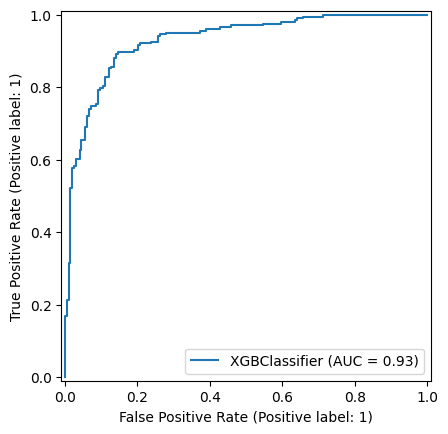

In [213]:
train, test = train_test_split(df, test_size=TEST_RATIO)
y_train, y_test = train['class'], test['class']
X_train, X_test = train.drop(['from','to','class'], axis=1), test.drop(['from','to','class'], axis=1)

xgb_classifier = xgb.XGBClassifier(n_estimators=100, objective='binary:logistic', tree_method='hist', eta=0.1, max_depth=3)
xgb_classifier.fit(X_train, y_train)


y_predict = xgb_classifier.predict(X_test)
print("ACC: ",accuracy_score(y_test,y_predict))
print("ROC: ",roc_auc_score(y_test,y_predict))
RocCurveDisplay.from_estimator(xgb_classifier, X_test, y_test)

ACC:  0.8678304239401496
ROC:  0.8679163142444897


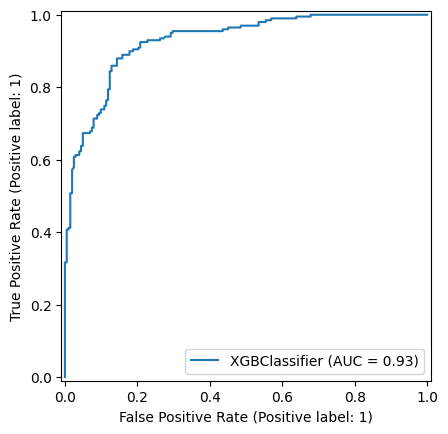

In [219]:
train, test = train_test_split(df, test_size=TEST_RATIO)
y_train, y_test = train['class'], test['class']
X_train, X_test = train.drop(['from','to','class'], axis=1), test.drop(['from','to','class'], axis=1)

xgb_classifier = xgb.XGBClassifier(n_estimators=100, objective='binary:logistic', tree_method='hist', eta=0.1, max_depth=3)
xgb_classifier.fit(X_train, y_train)

y_predict = xgb_classifier.predict(X_test)
print("ACC: ", accuracy_score(y_test, y_predict))
print("ROC: ", roc_auc_score(y_test, y_predict))
RocCurveDisplay.from_estimator(xgb_classifier, X_test, y_test)


#### Bonus

In [220]:
nodes_dict = {node: i for i, node in enumerate(graph.nodes())}

subtle_graph = nx.Graph()
for e1, e2 in graph.edges():
    subtle_graph.add_edge(nodes_dict[e1], nodes_dict[e2])

print(graph, nx.info(subtle_graph))

model = karateclub.DeepWalk()
model.fit(subtle_graph)
subtle_graph_embed = model.get_embedding()
subtle_graph_embed

DiGraph with 65 nodes and 1139 edges Graph with 65 nodes and 730 edges


array([[-0.06088009, -0.03735239, -0.11776278, ...,  0.1850959 ,
         0.12899263,  0.23264652],
       [-0.03710037, -0.02634274, -0.11483728, ...,  0.19498257,
         0.14640944,  0.23668218],
       [-0.01434216, -0.00967223, -0.09174727, ...,  0.20376915,
         0.17513505,  0.22637987],
       ...,
       [ 0.07950606, -0.0626754 , -0.10011711, ...,  0.06158311,
         0.12007681,  0.18691893],
       [ 0.07655532, -0.05958977, -0.14197268, ...,  0.06059205,
         0.07816928,  0.2173035 ],
       [ 0.09532788, -0.02541353, -0.04720455, ...,  0.04955911,
         0.15649043,  0.15205993]], dtype=float32)

In [221]:
def build_feature_embeddings(df, embed_matrix, nodes_dict):
    embeddings = np.array(
        [
            np.concatenate(
                [embed_matrix[nodes_dict[from_node]], embed_matrix[nodes_dict[to_node]]]
            )
            for from_node, to_node in zip(df["from"], df["to"])
        ]
    )

    embeddings_df = pd.DataFrame(
        embeddings, columns=[f"embedding_{i}" for i in range(embeddings.shape[1])]
    )

    df = df.reset_index(drop=True)
    embeddings_df = embeddings_df.reset_index(drop=True)
    return pd.concat([df, embeddings_df], axis=1)

ACC:  0.8753117206982544
ROC:  0.8754540026867009


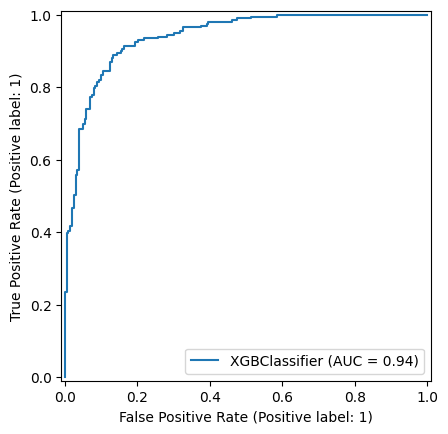

In [ ]:
train_stacked_df = build_feature_embeddings(train, subtle_graph_embed, nodes_dict)
test_stacked_df = build_feature_embeddings(test, subtle_graph_embed, nodes_dict)

all_columns = set(train_stacked_df.columns) | set(test_stacked_df.columns)

train_stacked_df = train_stacked_df.reindex(columns=all_columns, fill_value=0)
test_stacked_df = test_stacked_df.reindex(columns=all_columns, fill_value=0)

y_train, y_test = train_stacked_df["class"], test_stacked_df["class"]
X_train = train_stacked_df.drop(["class", "from", "to"], axis=1)
X_test = test_stacked_df.drop(["class", "from", "to"], axis=1)

xgb_classifier.fit(X_train, y_train)
y_predict = xgb_classifier.predict(X_test)

print("ACC: ", accuracy_score(y_test, y_predict))
print("ROC: ", roc_auc_score(y_test, y_predict))

RocCurveDisplay.from_estimator(xgb_classifier, X_test, y_test)

**Question 2:** Use three different centrality algorithms to identify managers at Enron.
    Evaluate the precision@10 of the algorithms, i.e. how many managers attained the top-10 highest ranks (30pt). Draw
    the network and visualize one of the centrality measures (10pt)
    

In [17]:
!wget https://www.cs.cmu.edu/~./enron/enron_mail_20150507.tar.gz
!tar -xvf enron_mail_20150507.tar.gz

--2025-04-15 20:45:20--  https://www.cs.cmu.edu/~./enron/enron_mail_20150507.tar.gz
Resolving www.cs.cmu.edu (www.cs.cmu.edu)... 128.2.42.95
Connecting to www.cs.cmu.edu (www.cs.cmu.edu)|128.2.42.95|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 443254787 (423M) [application/x-gzip]
Saving to: ‘enron_mail_20150507.tar.gz’

enron_mail_20150507 100%[===================>] 422.72M   768KB/s    in 17m 57s 

2025-04-15 21:03:18 (402 KB/s) - ‘enron_mail_20150507.tar.gz’ saved [443254787/443254787]

x maildir/
x maildir/blair-l/
x maildir/blair-l/personnel___promotions/
x maildir/blair-l/personnel___promotions/1.
x maildir/blair-l/meetings___nng_customer_mtg/
x maildir/blair-l/meetings___nng_customer_mtg/8.
x maildir/blair-l/meetings___nng_customer_mtg/16.
x maildir/blair-l/meetings___nng_customer_mtg/13.
x maildir/blair-l/meetings___nng_customer_mtg/14.
x maildir/blair-l/meetings___nng_customer_mtg/10.
x maildir/blair-l/meetings___nng_customer_mtg/9.
x maildir/blair

In [18]:
!wget https://web.archive.org/web/20221126083647if_/https://www.inf.ed.ac.uk/teaching/courses/tts/assessed/roles.txt

--2025-04-15 21:31:05--  https://web.archive.org/web/20221126083647if_/https://www.inf.ed.ac.uk/teaching/courses/tts/assessed/roles.txt
Resolving web.archive.org (web.archive.org)... 207.241.237.3
Connecting to web.archive.org (web.archive.org)|207.241.237.3|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 8867 (8.7K) [text/plain]
Saving to: ‘roles.txt’

roles.txt           100%[===================>]   8.66K  --.-KB/s    in 0s      

2025-04-15 21:31:08 (4.13 GB/s) - ‘roles.txt’ saved [8867/8867]



In [122]:
EMAIL_REGEX = re.compile(r"[a-zA-Z0-9_.+-]+@[a-zA-Z0-9-]+\.[a-zA-Z0-9-.]+")


def get_links_from_email(path):
    from_emails = []
    to_emails = []

    try:
        with open(path, "r", encoding="utf8", errors="ignore") as file:
            for line in file:
                line = line.strip().lower()
                if line.startswith("from:"):
                    from_emails = EMAIL_REGEX.findall(line)
                elif line.startswith("to:"):
                    to_emails = EMAIL_REGEX.findall(line)
    except (IOError, OSError):
        return set()

    return {(f, t) for f in from_emails for t in to_emails}


def get_all_links(maildir_root="./maildir"):
    links = set()
    pattern = os.path.join(maildir_root, "*", "*", "*")
    files = [p for p in glob(pattern) if "/inbox/" in p or "/sent/" in p]

    for path in files:
        if os.path.isfile(path):
            links.update(get_links_from_email(path))

    return links

In [130]:
links = get_all_links()
graph = nx.DiGraph()
graph.add_edges_from(links)

degree_centrality_d = nx.degree_centrality(graph)
sorted_degree_centrality_d = sorted(
    degree_centrality_d.items(), key=lambda item: item[1], reverse=True
)

eigenvector_centrality_d = nx.eigenvector_centrality(graph)
sorted_eigenvector_centrality_d = sorted(
    eigenvector_centrality_d.items(), key=lambda item: item[1], reverse=True
)

closeness_centrality_d = nx.closeness_centrality(graph)
sorted_closeness_centrality_d = sorted(
    closeness_centrality_d.items(), key=lambda item: item[1], reverse=True
)

In [131]:
df = pd.DataFrame(graph.nodes(), columns=["node_email"])
df["node_name"] = df.node_email.apply(lambda node_email: node_email.split("@")[0])
df.head()

,node_email,node_name
0,tana.jones@enron.com,tana.jones
1,richard.ramirez@lcra.org,richard.ramirez
2,eric.gadd@enron.com,eric.gadd
3,v.dickerson@enron.com,v.dickerson
4,mark.haedicke@enron.com,mark.haedicke


In [135]:
def is_manager(role):
    if pd.isna(role):
        return False
    return any(keyword in role for keyword in manager_keywords)

role_df = pd.read_csv(
    "roles.txt",
    sep="\t",
    header=None,
    names=["name", "role"],
    on_bad_lines="skip"  # replaces deprecated `error_bad_lines`
)

merged_df = df.merge(role_df, how="left", left_on="node_name", right_on="name")

manager_keywords = [
    "Vice President",
    "President",
    "Manager",
    "Managing Director",
    "Director",
    "CEO",
]

merged_df["managers"] = merged_df["role"].apply(is_manager)

merged_df.head()

,node_email,node_name,name,role,managers
0,tana.jones@enron.com,tana.jones,tana.jones,Tana Jones N/A,False
1,richard.ramirez@lcra.org,richard.ramirez,NaN,NaN,False
2,eric.gadd@enron.com,eric.gadd,NaN,NaN,False
3,v.dickerson@enron.com,v.dickerson,NaN,NaN,False
4,mark.haedicke@enron.com,mark.haedicke,mark.haedicke,Mark Haedicke Managing Director Lega...,True


degree_centrality precision@10: 0.30
eigenvector_centrality precision@10: 0.70
closeness_centrality precision@10: 0.80


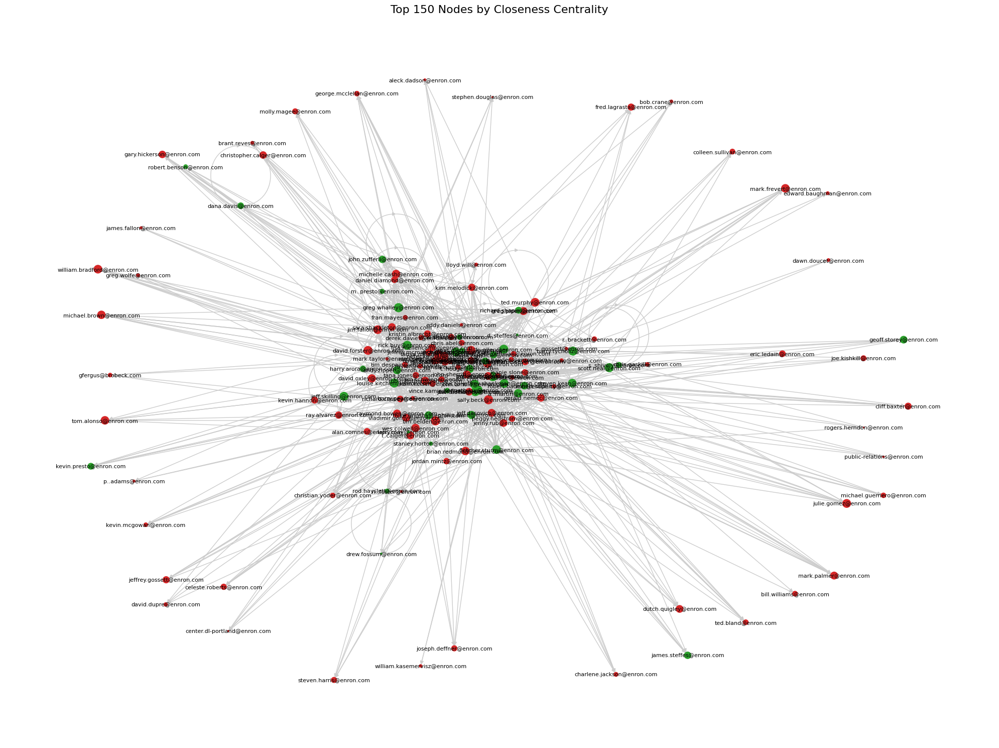

In [134]:
centrality_measures = {
    "degree_centrality": sorted_degree_centrality_d,
    "eigenvector_centrality": sorted_eigenvector_centrality_d,
    "closeness_centrality": sorted_closeness_centrality_d,
}

for name, sorted_centrality in centrality_measures.items():
    top_nodes = [node for node, _ in sorted_centrality[:10]]
    count = merged_df[merged_df.node_email.isin(top_nodes)].managers.sum()
    precision = count / 10
    print(f"{name} precision@10: {precision:.2f}")

top_n = 150
nodelist = [node for node, _ in sorted_closeness_centrality_d[:top_n]]
node_size = [top_n - idx for idx in range(top_n)]

# Define colors
def get_node_color(node_email):
    is_manager = merged_df[merged_df.node_email == node_email].managers.item()
    return "#2ca02c" if is_manager else "#d62728" 

node_color = [get_node_color(node) for node in nodelist]

subgraph = graph.subgraph(nodelist)

plt.figure(figsize=(20, 15))
nx.draw_networkx(
    subgraph,
    with_labels=True,
    nodelist=nodelist,
    node_size=node_size,
    node_color=node_color,
    font_size=8,
    edge_color="#cccccc",
)
plt.title("Top 150 Nodes by Closeness Centrality", fontsize=16)
plt.axis("off")
plt.tight_layout()
plt.show()
